In [1]:
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import numpy as np
import seaborn as sns

In [2]:
import altair as alt

In [49]:
df = pd.read_parquet("./../../../resulting data/verses_features.parquet")

In [50]:
df.head()

,bible_identifier,bible_book,bible_chapter,bible_book_chapter,genre,twitter_freq_sum_2014_2015,twitter_freq_2014,twitter_freq_2015,relations,monogamy,...,#org35,#org439,#pla65,#pla68,#per116,#per119,#pla67,#org52,#per129,#pla74
0,b.GEN.001.001,GEN,001,GEN.001,historical,49268,26376,22892,0,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,b.GEN.001.002,GEN,001,GEN.001,historical,8601,3693,4908,0,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,b.GEN.001.003,GEN,001,GEN.001,historical,20970,8816,12154,0,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,b.GEN.001.004,GEN,001,GEN.001,historical,4222,2286,1936,0,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,b.GEN.001.005,GEN,001,GEN.001,historical,3208,1666,1542,0,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [51]:
df["bible_book"]

0        GEN
1        GEN
2        GEN
3        GEN
4        GEN
        ... 
31060    REV
31061    REV
31062    REV
31063    REV
31064    REV
Name: bible_book, Length: 31065, dtype: object

In [52]:
#df.groupby("bible_book").mode()

In [53]:
df.shape

(31065, 4167)

In [54]:
#tokens_df = pd.read_parquet("./../../../resulting data/tokens_reinaValera95.parquet")

In [55]:
#tokens_df.shape

In [56]:
#tokens_df.sum().sum()

In [57]:
df["bible_book"].unique()

array(['GEN', 'EXO', 'LEV', 'NUM', 'DEU', 'JOS', 'JDG', 'RUT', '1SA',
       '2SA', '1KI', '2KI', '1CH', '2CH', 'EZR', 'NEH', 'EST', 'JOB',
       'PSA', 'PRO', 'ECC', 'SON', 'ISA', 'LAM', 'JER', 'EZE', 'DAN',
       'HOS', 'JOE', 'AMO', 'OBA', 'JON', 'MIC', 'NAH', 'HAB', 'ZEP',
       'HAG', 'ZEC', 'MAL', 'MAT', 'MAR', 'LUK', 'JOH', 'ACT', 'ROM',
       '1CO', '2CO', 'GAL', 'EPH', 'PHI', 'COL', '1TH', '2TH', '1TI',
       '2TI', 'TIT', 'PHM', 'HEB', 'JAM', '1PE', '2PE', '1JO', '2JO',
       '3JO', 'JUD', 'REV'], dtype=object)

In [58]:
df.fillna(0, inplace=True)

In [59]:
df.columns.tolist()[0:10]

['bible_identifier',
 'bible_book',
 'bible_chapter',
 'bible_book_chapter',
 'genre',
 'twitter_freq_sum_2014_2015',
 'twitter_freq_2014',
 'twitter_freq_2015',
 'relations',
 'monogamy']

In [60]:
structural_features = df.columns.tolist()[265:297]


In [61]:
sexual_features = df.columns.tolist()[8:262]

In [62]:
len(df)

31065

In [63]:
entities_features = df.columns.tolist()[262:265] + df.columns.tolist()[298:len(df)]

In [64]:
df.loc[df["bible_identifier"] == "b.SON.001.010"]["#per39"]

17547    1.0
Name: #per39, dtype: float64

In [65]:
df.describe()

KeyboardInterrupt: 

In [67]:
df

,bible_identifier,bible_book,bible_chapter,bible_book_chapter,genre,twitter_freq_sum_2014_2015,twitter_freq_2014,twitter_freq_2015,relations,monogamy,...,#org35,#org439,#pla65,#pla68,#per116,#per119,#pla67,#org52,#per129,#pla74
0,b.GEN.001.001,GEN,001,GEN.001,historical,49268,26376,22892,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,b.GEN.001.002,GEN,001,GEN.001,historical,8601,3693,4908,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,b.GEN.001.003,GEN,001,GEN.001,historical,20970,8816,12154,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,b.GEN.001.004,GEN,001,GEN.001,historical,4222,2286,1936,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,b.GEN.001.005,GEN,001,GEN.001,historical,3208,1666,1542,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
31060,b.REV.022.017,REV,022,REV.022,apocalyptic,8693,4633,4060,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
31061,b.REV.022.018,REV,022,REV.022,apocalyptic,4396,1939,2457,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
31062,b.REV.022.019,REV,022,REV.022,apocalyptic,3947,1952,1995,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
31063,b.REV.022.020,REV,022,REV.022,apocalyptic,11981,6014,5967,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


,genre,bible_book
0,historical,GEN
1533,historical,EXO
2746,law,LEV
3605,law,NUM
4893,law,DEU
...,...,...
30504,letter,1JO
30609,letter,2JO
30622,letter,3JO
30636,letter,JUD


In [71]:
books_df = df.groupby("bible_book").sum()

In [72]:
books_df

,twitter_freq_sum_2014_2015,twitter_freq_2014,twitter_freq_2015,relations,monogamy,poligamy,marriage,second-marriage,second-marriage-divorce,second-marriage-widow,...,#org35,#org439,#pla65,#pla68,#per116,#per119,#pla67,#org52,#per129,#pla74
bible_book,,,,,,,,,,,,,,,,,,,,,
1CH,244312,123407,120905,0,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1CO,2658801,1637393,1021408,7,0,0,16,2,0,1,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1JO,1595001,1043423,551578,0,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1KI,225574,118378,107196,0,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1PE,1325301,853718,471583,0,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
RUT,27430,11254,16176,0,2,0,5,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
SON,68811,35096,33715,0,0,1,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
TIT,172005,107460,64545,0,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [73]:
books_df["number of verses"] = df.groupby("bible_book").count().iloc[:,0].values.tolist()


In [74]:
books_df = books_df.loc[df["bible_book"].unique()]


In [75]:
books_df

,twitter_freq_sum_2014_2015,twitter_freq_2014,twitter_freq_2015,relations,monogamy,poligamy,marriage,second-marriage,second-marriage-divorce,second-marriage-widow,...,#org439,#pla65,#pla68,#per116,#per119,#pla67,#org52,#per129,#pla74,number of verses
bible_book,,,,,,,,,,,,,,,,,,,,,
GEN,938570,467676,470894,0,1,10,18,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1533
EXO,532548,256961,275587,0,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1213
LEV,206505,91530,114975,0,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,859
NUM,191596,95279,96317,0,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1288
DEU,568536,335272,233264,0,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,959
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1JO,1595001,1043423,551578,0,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,105
2JO,23028,14143,8885,0,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,13
3JO,48185,27678,20507,0,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,14


In [76]:
rel_books_df = books_df.div(books_df["number of verses"], axis="index")

In [77]:
books_df

,twitter_freq_sum_2014_2015,twitter_freq_2014,twitter_freq_2015,relations,monogamy,poligamy,marriage,second-marriage,second-marriage-divorce,second-marriage-widow,...,#org439,#pla65,#pla68,#per116,#per119,#pla67,#org52,#per129,#pla74,number of verses
bible_book,,,,,,,,,,,,,,,,,,,,,
GEN,938570,467676,470894,0,1,10,18,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1533
EXO,532548,256961,275587,0,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1213
LEV,206505,91530,114975,0,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,859
NUM,191596,95279,96317,0,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1288
DEU,568536,335272,233264,0,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,959
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1JO,1595001,1043423,551578,0,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,105
2JO,23028,14143,8885,0,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,13
3JO,48185,27678,20507,0,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,14


In [78]:
entities_df = pd.read_excel("./../../../entities.xls")


In [79]:
entities_df.index = entities_df["id"]


In [80]:
[entity for entity in rel_books_df.loc["SON"][entities_features].sort_values(ascending=False)[0:100].index.tolist() if ("org" in entity or "per" in entity ) and "per0" not in entity ]

['#per1876',
 '#per39',
 '#org391',
 '#org0',
 '#org122',
 '#org24',
 '#per1877',
 '#org100',
 '#org150',
 '#org21',
 '#per35',
 '#org183',
 '#org70',
 '#per779',
 '#per600',
 '#org174',
 '#org218',
 '#per1021',
 '#per997',
 '#per1016',
 '#per1013',
 '#org140',
 '#per650',
 '#org232',
 '#org172',
 '#per1018',
 '#per938']

In [81]:

rel_books_df["bible_book"] = rel_books_df.index

In [82]:
rel_books_df[structural_features].columns.tolist()

['number of entities referred',
 'number of different entities referred',
 'number of people',
 'number of different number of people',
 'number of groups',
 'number of different number of groups',
 'number of places',
 'number of different number of places',
 'number of times',
 'number of different number of times',
 'number of works',
 'number of different number of works',
 'number of 1st level quotations',
 'number of 2nd level quotations',
 'number of 3rd level quotations',
 'number of 4th level quotations',
 'number of 5th level quotations',
 'number of 6th level quotations',
 'number of 7th level quotations',
 'number of quotations',
 'number of entities communicating',
 'number of different entities communicating',
 'number of entities receiving communication',
 'number of different entities receiving communication',
 'number of oral quotations',
 'number of dream quotations',
 'number of praying quotations',
 'number of oath quotations',
 'number of written quotations',
 'num

In [84]:
df

,bible_identifier,bible_book,bible_chapter,bible_book_chapter,genre,twitter_freq_sum_2014_2015,twitter_freq_2014,twitter_freq_2015,relations,monogamy,...,#org35,#org439,#pla65,#pla68,#per116,#per119,#pla67,#org52,#per129,#pla74
0,b.GEN.001.001,GEN,001,GEN.001,historical,49268,26376,22892,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,b.GEN.001.002,GEN,001,GEN.001,historical,8601,3693,4908,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,b.GEN.001.003,GEN,001,GEN.001,historical,20970,8816,12154,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,b.GEN.001.004,GEN,001,GEN.001,historical,4222,2286,1936,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,b.GEN.001.005,GEN,001,GEN.001,historical,3208,1666,1542,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
31060,b.REV.022.017,REV,022,REV.022,apocalyptic,8693,4633,4060,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
31061,b.REV.022.018,REV,022,REV.022,apocalyptic,4396,1939,2457,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
31062,b.REV.022.019,REV,022,REV.022,apocalyptic,3947,1952,1995,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
31063,b.REV.022.020,REV,022,REV.022,apocalyptic,11981,6014,5967,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [87]:
rel_books_df

,twitter_freq_sum_2014_2015,twitter_freq_2014,twitter_freq_2015,relations,monogamy,poligamy,marriage,second-marriage,second-marriage-divorce,second-marriage-widow,...,#pla65,#pla68,#per116,#per119,#pla67,#org52,#per129,#pla74,number of verses,bible_book
bible_book,,,,,,,,,,,,,,,,,,,,,
GEN,612.243966,305.072407,307.171559,0.0,0.000652,0.006523,0.011742,0.0,0.0,0.0,...,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,GEN
EXO,439.033800,211.839242,227.194559,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,...,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,EXO
LEV,240.401630,106.554133,133.847497,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,...,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,LEV
NUM,148.754658,73.974379,74.780280,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,...,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,NUM
DEU,592.842544,349.605839,243.236705,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,...,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,DEU
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1JO,15190.485714,9937.361905,5253.123810,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,...,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,1JO
2JO,1771.384615,1087.923077,683.461538,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,...,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,2JO
3JO,3441.785714,1977.000000,1464.785714,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,...,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,3JO


In [91]:
rel_books_df.reset_index(inplace=True)

In [90]:
rel_books_df.drop("bible_book", axis=1, inplace=True)

In [93]:
rel_books_df

,bible_book,twitter_freq_sum_2014_2015,twitter_freq_2014,twitter_freq_2015,relations,monogamy,poligamy,marriage,second-marriage,second-marriage-divorce,...,#org439,#pla65,#pla68,#per116,#per119,#pla67,#org52,#per129,#pla74,number of verses
0,GEN,612.243966,305.072407,307.171559,0.0,0.000652,0.006523,0.011742,0.0,0.0,...,0.00000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0
1,EXO,439.033800,211.839242,227.194559,0.0,0.000000,0.000000,0.000000,0.0,0.0,...,0.00000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0
2,LEV,240.401630,106.554133,133.847497,0.0,0.000000,0.000000,0.000000,0.0,0.0,...,0.00000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0
3,NUM,148.754658,73.974379,74.780280,0.0,0.000000,0.000000,0.000000,0.0,0.0,...,0.00000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0
4,DEU,592.842544,349.605839,243.236705,0.0,0.000000,0.000000,0.000000,0.0,0.0,...,0.00000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
61,1JO,15190.485714,9937.361905,5253.123810,0.0,0.000000,0.000000,0.000000,0.0,0.0,...,0.00000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0
62,2JO,1771.384615,1087.923077,683.461538,0.0,0.000000,0.000000,0.000000,0.0,0.0,...,0.00000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0
63,3JO,3441.785714,1977.000000,1464.785714,0.0,0.000000,0.000000,0.000000,0.0,0.0,...,0.00000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0
64,JUD,4357.760000,2860.640000,1497.120000,0.0,0.000000,0.000000,0.000000,0.0,0.0,...,0.00000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0


In [95]:
rel_books_df = pd.merge(df.groupby("bible_book").head(1)[["genre","bible_book"]]
, rel_books_df, on='bible_book')

In [96]:
rel_books_df

,genre,bible_book,twitter_freq_sum_2014_2015,twitter_freq_2014,twitter_freq_2015,relations,monogamy,poligamy,marriage,second-marriage,...,#org439,#pla65,#pla68,#per116,#per119,#pla67,#org52,#per129,#pla74,number of verses
0,historical,GEN,612.243966,305.072407,307.171559,0.0,0.000652,0.006523,0.011742,0.0,...,0.00000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0
1,historical,EXO,439.033800,211.839242,227.194559,0.0,0.000000,0.000000,0.000000,0.0,...,0.00000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0
2,law,LEV,240.401630,106.554133,133.847497,0.0,0.000000,0.000000,0.000000,0.0,...,0.00000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0
3,law,NUM,148.754658,73.974379,74.780280,0.0,0.000000,0.000000,0.000000,0.0,...,0.00000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0
4,law,DEU,592.842544,349.605839,243.236705,0.0,0.000000,0.000000,0.000000,0.0,...,0.00000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
61,letter,1JO,15190.485714,9937.361905,5253.123810,0.0,0.000000,0.000000,0.000000,0.0,...,0.00000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0
62,letter,2JO,1771.384615,1087.923077,683.461538,0.0,0.000000,0.000000,0.000000,0.0,...,0.00000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0
63,letter,3JO,3441.785714,1977.000000,1464.785714,0.0,0.000000,0.000000,0.000000,0.0,...,0.00000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0
64,letter,JUD,4357.760000,2860.640000,1497.120000,0.0,0.000000,0.000000,0.000000,0.0,...,0.00000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0


# Visualizations

In [85]:
rel_books_df

,twitter_freq_sum_2014_2015,twitter_freq_2014,twitter_freq_2015,relations,monogamy,poligamy,marriage,second-marriage,second-marriage-divorce,second-marriage-widow,...,#pla65,#pla68,#per116,#per119,#pla67,#org52,#per129,#pla74,number of verses,bible_book
bible_book,,,,,,,,,,,,,,,,,,,,,
GEN,612.243966,305.072407,307.171559,0.0,0.000652,0.006523,0.011742,0.0,0.0,0.0,...,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,GEN
EXO,439.033800,211.839242,227.194559,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,...,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,EXO
LEV,240.401630,106.554133,133.847497,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,...,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,LEV
NUM,148.754658,73.974379,74.780280,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,...,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,NUM
DEU,592.842544,349.605839,243.236705,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,...,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,DEU
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1JO,15190.485714,9937.361905,5253.123810,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,...,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,1JO
2JO,1771.384615,1087.923077,683.461538,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,...,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,2JO
3JO,3441.785714,1977.000000,1464.785714,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,...,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,3JO


In [38]:
alt.Chart(rel_books_df).mark_bar().encode(
    x='bible_book',
    y='number of quotations'
).interactive()

alt.Chart(...)

In [101]:
rel_books_df["number of people"]

0     3.680365
1     2.701566
2     3.753201
3     2.781832
4     2.349322
        ...   
61    1.561905
62    1.153846
63    0.785714
64    1.600000
65    1.628713
Name: number of people, Length: 66, dtype: float64

In [104]:
alt.Chart(rel_books_df).mark_circle(size=60).encode(
    x='number of people',
    y='number of places',
    color='genre',
    size = "number of groups",
    tooltip=['bible_book', 'number of groups']
).interactive()

alt.Chart(...)

In [37]:
alt.Chart(rel_books_df).mark_rect().encode(
    x='bible_book:O',
    y='number of groups:O',
    color='number of places:Q'
)

alt.Chart(...)

In [ ]:
'number of groups',
 'number of different number of groups',
 'number of places',

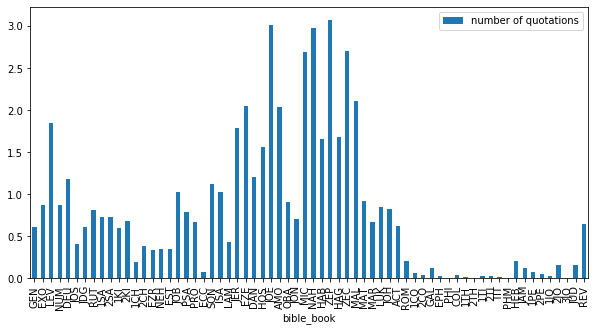

In [28]:
rel_books_df.plot(kind="bar", y=['number of quotations'], figsize=(10,5))

array([<matplotlib.axes._subplots.AxesSubplot object at 0x000001C439DAE448>,
      dtype=object)

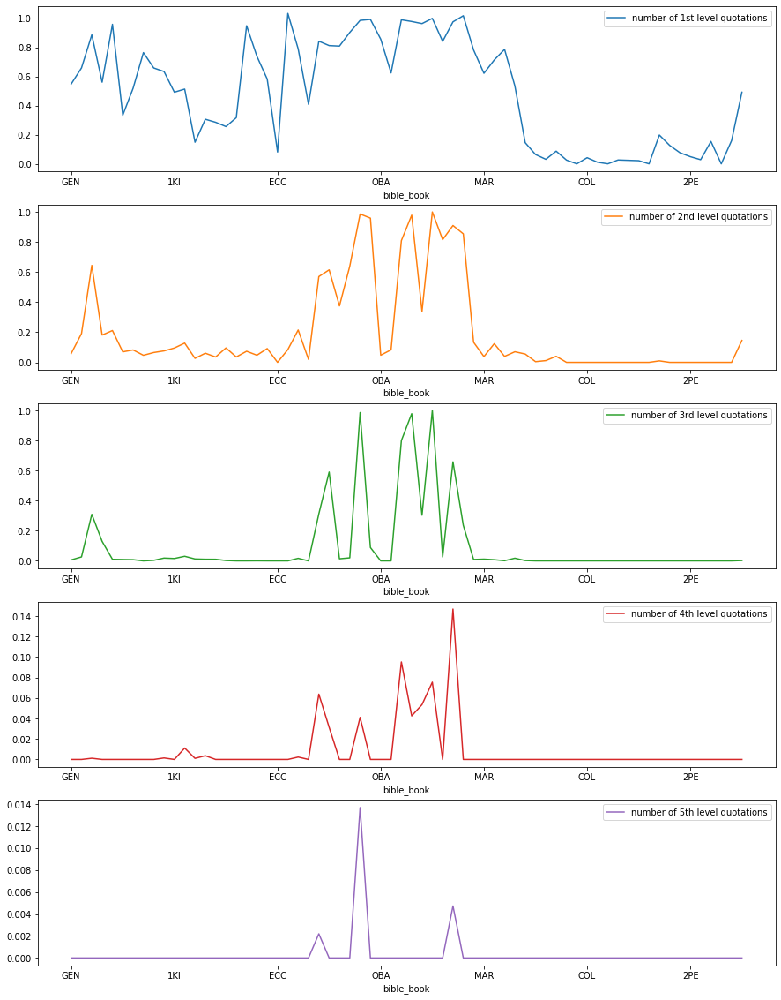

In [29]:

fig, axes = plt.subplots(nrows=1, ncols=1, figsize=(15,20))

#quantitative_data.plot(kind="bar", x ="id", y = 'number verses', rot=90, figsize=(15,10), ax=axes[0])
#quantitative_data.plot(kind="bar", x ="id", y = 'number chapters', rot=90, figsize=(15,10), ax=axes[1])

rel_books_df.plot(kind="line", y=['number of 1st level quotations',
 'number of 2nd level quotations',
 'number of 3rd level quotations',
 'number of 4th level quotations',
 'number of 5th level quotations'], subplots=True, ax=axes)



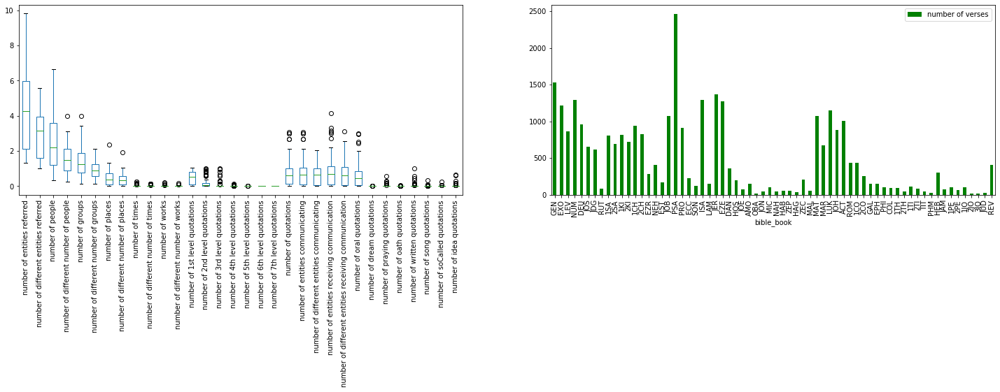

In [30]:
import matplotlib.pyplot as plt

fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(25,5))

rel_books_df[structural_features].plot.box(rot=90, ax=axes[0])
books_df.plot(kind="bar", y="number of verses", color="green", ax=axes[1])

#fig.savefig("./fig.png")

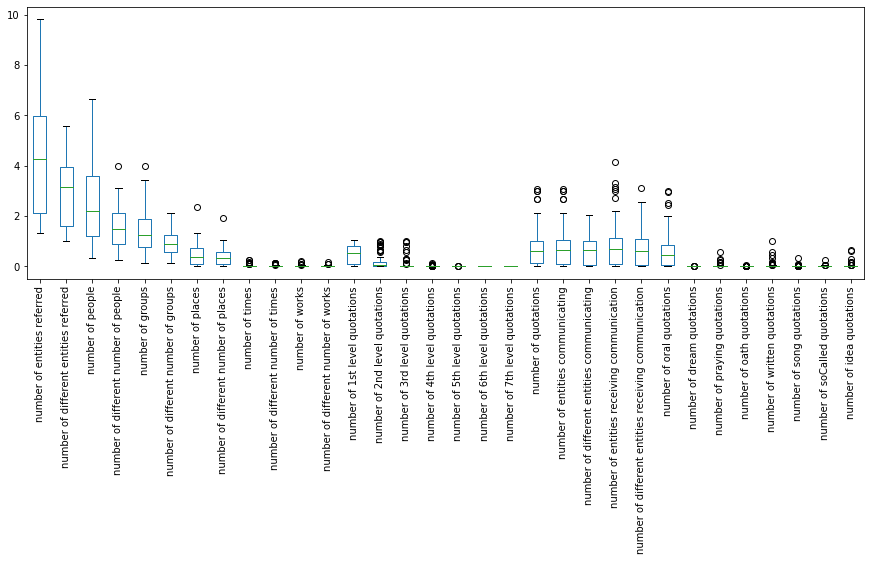

In [31]:
rel_books_df[structural_features].plot.box(rot=90, figsize=(15,5))


<function matplotlib.pyplot.show(*args, **kw)>

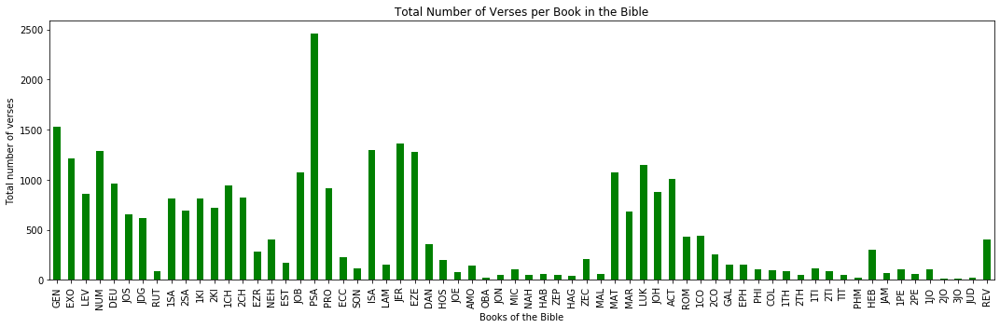

In [32]:
fig, axes = plt.subplots(nrows=1, ncols=1, figsize = (15,5))

books_df.plot(kind="bar", y="number of verses", color="green", ax = axes, legend=None, title = "Total Number of Verses per Book in the Bible")

axes.set_ylabel("Total number of verses")
axes.set_xlabel("Books of the Bible")

plt.tight_layout()

fig.savefig("./../../../visualizations/features/bar_verses_bible.png", bbox_inches="tight")
plt.show



In [33]:
structural_features

['number of entities referred',
 'number of different entities referred',
 'number of people',
 'number of different number of people',
 'number of groups',
 'number of different number of groups',
 'number of places',
 'number of different number of places',
 'number of times',
 'number of different number of times',
 'number of works',
 'number of different number of works',
 'number of 1st level quotations',
 'number of 2nd level quotations',
 'number of 3rd level quotations',
 'number of 4th level quotations',
 'number of 5th level quotations',
 'number of 6th level quotations',
 'number of 7th level quotations',
 'number of quotations',
 'number of entities communicating',
 'number of different entities communicating',
 'number of entities receiving communication',
 'number of different entities receiving communication',
 'number of oral quotations',
 'number of dream quotations',
 'number of praying quotations',
 'number of oath quotations',
 'number of written quotations',
 'num

In [34]:
rel_books_df[["number of people","number of groups", "number of places"]]

,number of people,number of groups,number of places
bible_book,,,
GEN,3.680365,0.685584,0.523810
EXO,2.701566,1.160758,0.436933
LEV,3.753201,1.882421,0.350407
NUM,2.781832,2.087733,0.623447
DEU,2.349322,2.440042,0.759124
...,...,...,...
1JO,1.561905,0.752381,0.019048
2JO,1.153846,1.000000,0.000000
3JO,0.785714,0.714286,0.000000


<function matplotlib.pyplot.show(*args, **kw)>

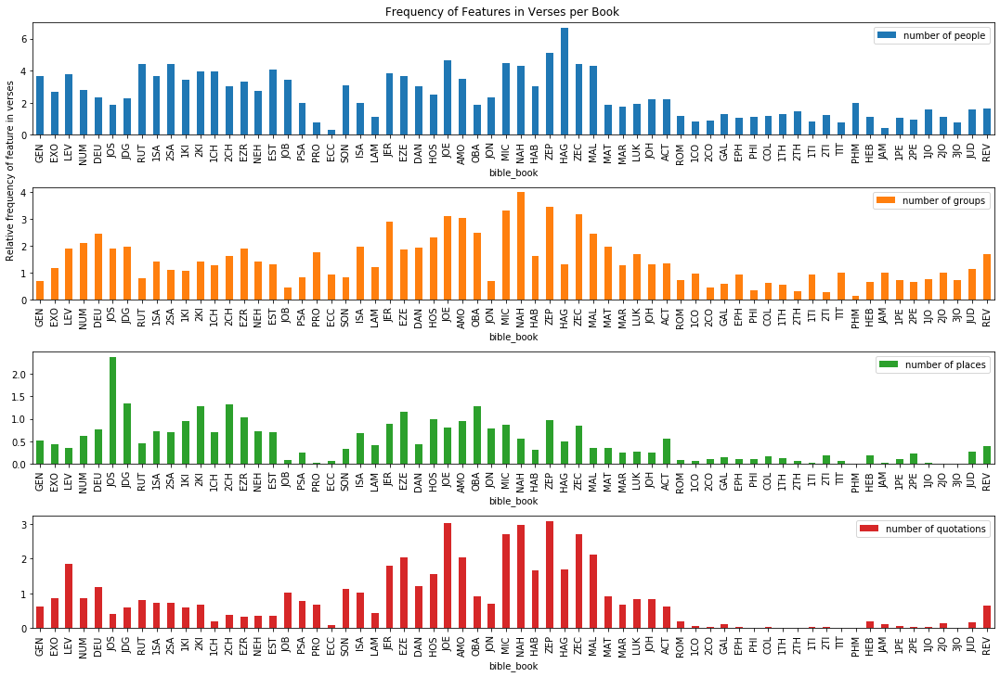

In [35]:

fig, axes = plt.subplots(nrows=1, ncols=1, figsize=(15,10))

rel_books_df.plot(kind = "bar", y = ["number of people","number of groups", "number of places", "number of quotations"], ax = axes, subplots = True,  legend=True, title = ["", "", "", ""])

#rel_books_df.plot(kind="bar", y=["number of different people","number of different groups", "number of different places"], stacked=True, ax = axes)
#relative_quantitative_data.plot(kind="bar", x="id", y=["number of different people","number of different groups", "number of different places"], stacked=True, ax = axes[1])
#fig.set_title

#axes.set_ylabel('yA')

fig.suptitle('Frequency of Features in Verses per Book', y = 1.01)
#fig.subplots_adjust(hspace=0.5, left=0.5)
fig.text(0.01, 0.9, "Relative frequency of feature in verses", ha="center", va="top", rotation=90)

#axes.set_xticks(relative_quantitative_data.order.tolist(), relative_quantitative_data.id.tolist())

#axes[1].title.set_text('First Plot')

#axes[1].set_title = "Number of different entities in each book of the Bible (relative to number of verses)"



plt.subplots_adjust(top = 0.9, left = 0.05, bottom = 0.15)  

plt.tight_layout()

fig.savefig("./../../../visualizations/features/bar_people_groups_places_quotations_bible.png", bbox_inches="tight")
plt.show



<function matplotlib.pyplot.show(*args, **kw)>

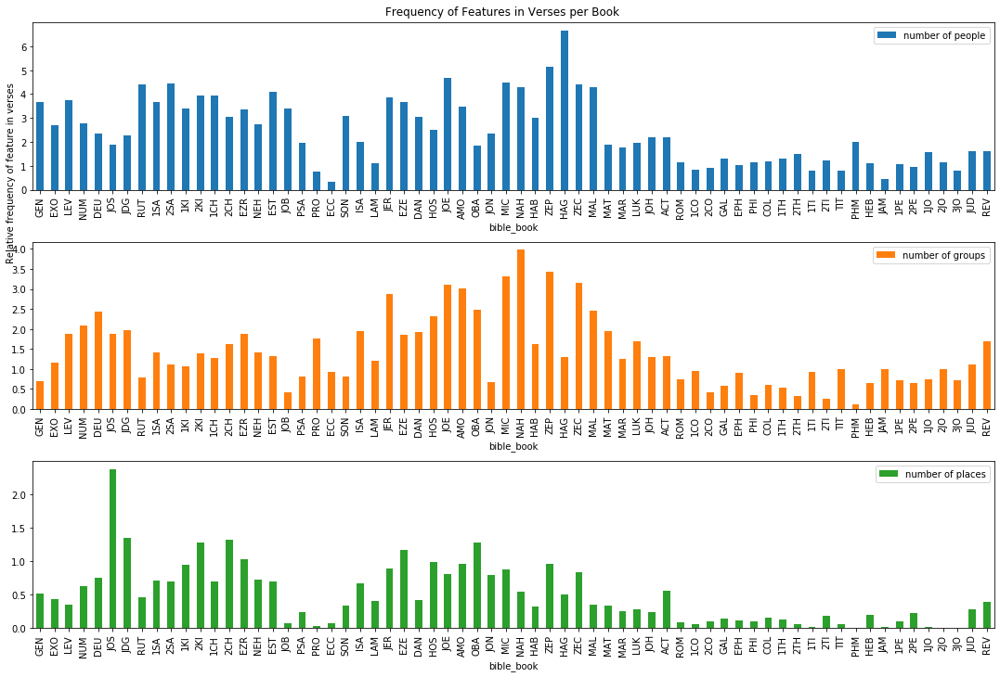

In [36]:

fig, axes = plt.subplots(nrows=1, ncols=1, figsize=(15,10))

rel_books_df.plot(kind = "bar", y = ["number of people","number of groups", "number of places"], ax = axes, subplots = True,  legend=True, title = ["", "", ""])

#rel_books_df.plot(kind="bar", y=["number of different people","number of different groups", "number of different places"], stacked=True, ax = axes)
#relative_quantitative_data.plot(kind="bar", x="id", y=["number of different people","number of different groups", "number of different places"], stacked=True, ax = axes[1])
#fig.set_title

#axes.set_ylabel('yA')

fig.suptitle('Frequency of Features in Verses per Book', y = 1.01)
#fig.subplots_adjust(hspace=0.5, left=0.5)
fig.text(0.01, 0.9, "Relative frequency of feature in verses ", ha="center", va="top", rotation=90)


#axes.set_xticks(relative_quantitative_data.order.tolist(), relative_quantitative_data.id.tolist())

#axes[1].title.set_text('First Plot')

#axes[1].set_title = "Number of different entities in each book of the Bible (relative to number of verses)"



plt.subplots_adjust(top = 0.9, left = 0.05, bottom = 0.15)  

plt.tight_layout()

fig.savefig("./../../../visualizations/features/bar_people_groups_places_bible.png", bbox_inches="tight")
plt.show



<function matplotlib.pyplot.show(*args, **kw)>

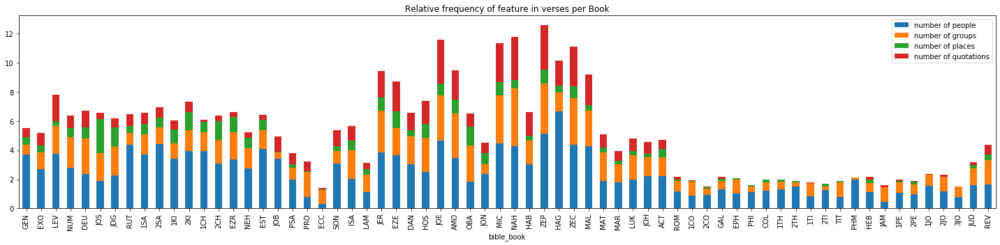

In [37]:

fig, axes = plt.subplots(nrows=1, ncols=1, figsize=(15,5))

rel_books_df.plot(kind="bar", y=["number of people","number of groups", "number of places", "number of quotations"], figsize=(20,5), ax=axes, stacked=True)

#rel_books_df.plot(kind="bar", y=["number of different people","number of different groups", "number of different places"], stacked=True, ax = axes)
#relative_quantitative_data.plot(kind="bar", x="id", y=["number of different people","number of different groups", "number of different places"], stacked=True, ax = axes[1])
#fig.set_title

axes.title.set_text('Relative frequency of feature in verses per Book')

#axes.set_xticks(relative_quantitative_data.order.tolist(), relative_quantitative_data.id.tolist())

#axes[1].title.set_text('First Plot')

#axes[1].set_title = "Number of different entities in each book of the Bible (relative to number of verses)"
plt.tight_layout()

#fig.savefig("./fig.png")
fig.savefig("./../../../visualizations/features/stacked_bar_people_groups_places_quotations_bible.png")
plt.show



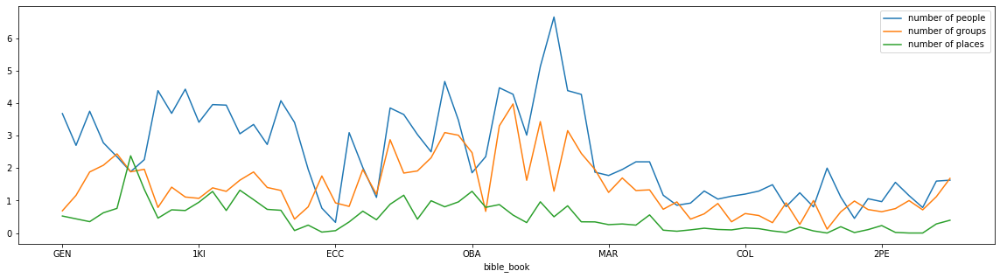

In [38]:
rel_books_df.plot(kind="line",  y=["number of people","number of groups", "number of places"], figsize=(20,5))

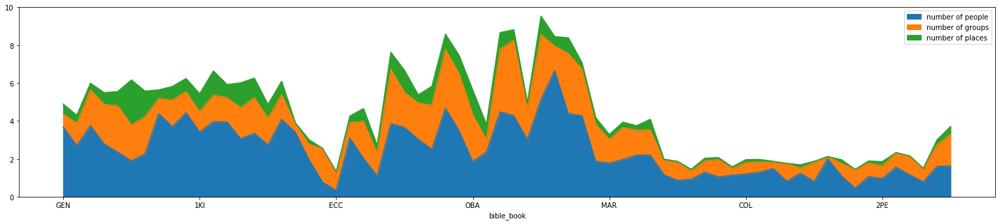

In [39]:
rel_books_df.plot(kind="area", y=["number of people","number of groups", "number of places"], figsize=(25,5))

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x000001C43A7CC488>],
      dtype=object)

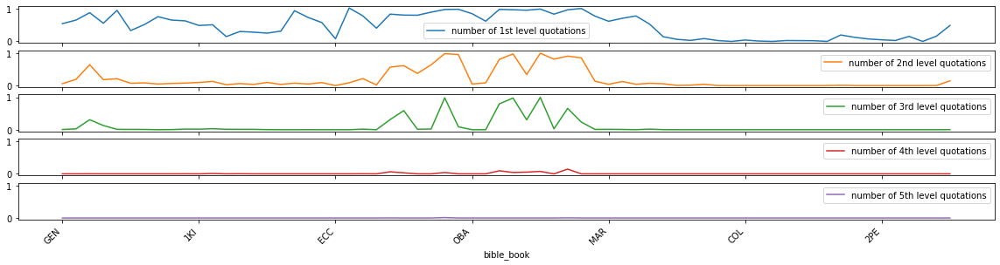

In [40]:
rel_books_df.plot(kind="line", y=['number of 1st level quotations',
 'number of 2nd level quotations',
 'number of 3rd level quotations',
 'number of 4th level quotations',
 'number of 5th level quotations'], figsize=(20,5), rot=45, subplots=True, sharey = True, layout = (5, 1), x_compat=True)
#plt.xticks(relative_quantitative_data["id"].tolist())

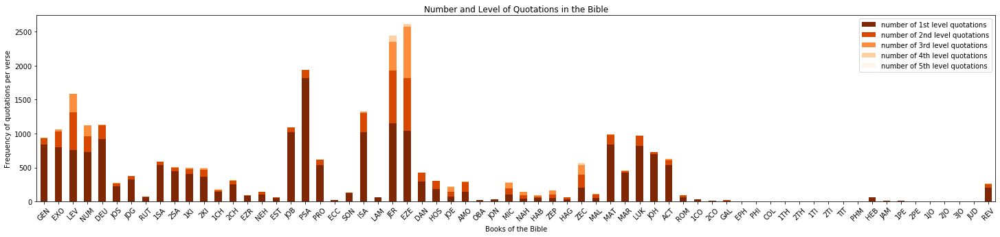

In [41]:
fig, axes = plt.subplots(nrows=1, ncols=1, figsize=(15,5))

#axes.set_xticks(relative_quantitative_data.order.tolist(), relative_quantitative_data.id.tolist())

books_df.plot(kind="bar", y=['number of 1st level quotations',
 'number of 2nd level quotations',
 'number of 3rd level quotations',
 'number of 4th level quotations',
 'number of 5th level quotations'], stacked = True, figsize=(25,5), cmap="Oranges_r", rot=45, ax = axes, title = "Number and Level of Quotations in the Bible")

axes.set_ylabel("Frequency of quotations per verse")
axes.set_xlabel("Books of the Bible")

fig.savefig("./../../../visualizations/features/stacked_bars_total_levels_quotations_bible.png")



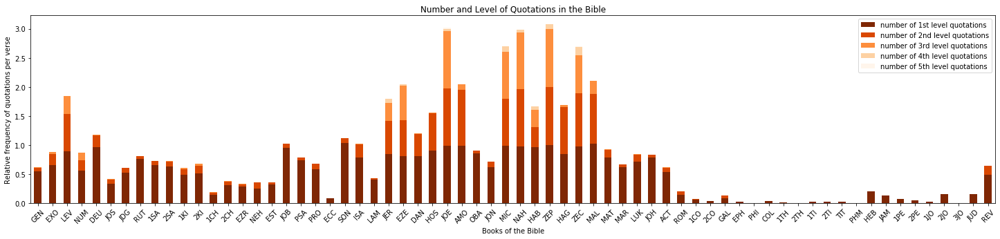

In [42]:
fig, axes = plt.subplots(nrows=1, ncols=1, figsize=(15,5))

#axes.set_xticks(relative_quantitative_data.order.tolist(), relative_quantitative_data.id.tolist())

rel_books_df.plot(kind="bar", y=['number of 1st level quotations',
 'number of 2nd level quotations',
 'number of 3rd level quotations',
 'number of 4th level quotations',
 'number of 5th level quotations'], stacked = True, figsize=(25,5), cmap="Oranges_r", rot=45, ax = axes, title = "Number and Level of Quotations in the Bible")

axes.set_ylabel("Relative frequency of quotations per verse")
axes.set_xlabel("Books of the Bible")

#plt.xticks(relative_quantitative_data["id"].tolist())
#axes.tick_params(axis='x', which='minor', bottom=True)
#axes.tick_params(axis='x', which='major', bottom=True)

fig.savefig("./../../../visualizations/features/stacked_bars_rel_levels_quotations_bible.png")



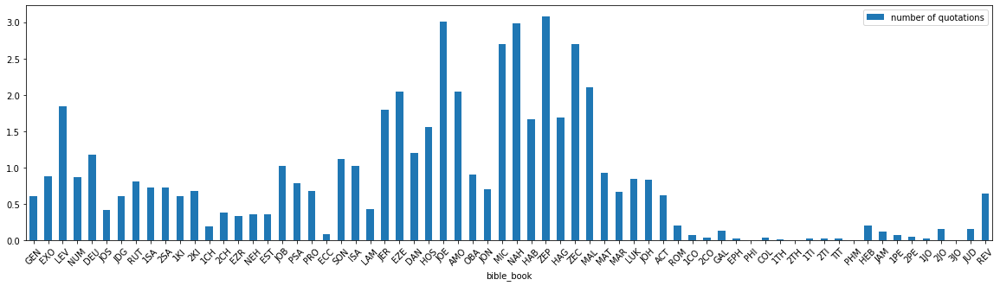

In [43]:
rel_books_df.plot(kind="bar", y=['number of quotations'], figsize=(20,5), rot=45)
#plt.xticks(relative_quantitative_data["id"].tolist())
plt.savefig("./../../../visualizations/features/bars_quotations.png")


In [ ]:
rel_books_df.plot(kind="bar",  y=['number of oral quotations',
 'number of dream quotations',
 'number of praying quotations',
 'number of written quotations',
 'number of song quotations'
 ], stacked=True, figsize=(20,5))

plt.savefig("./../../../visualizations/features/stacked_bars_types_quotations_selected.png")


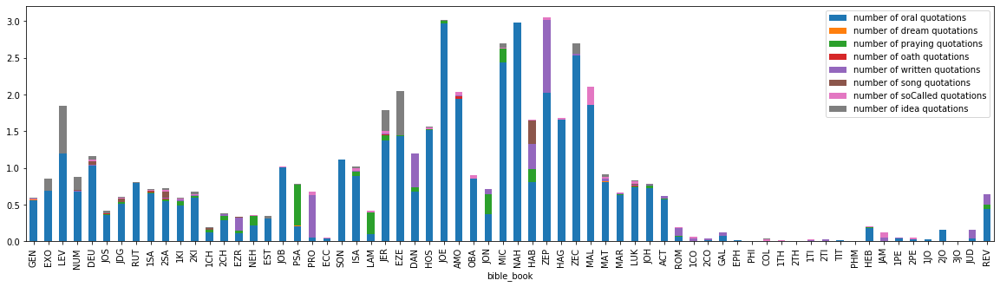

In [39]:
rel_books_df.plot(kind="bar", y=['number of oral quotations',
 'number of dream quotations',
 'number of praying quotations',
 'number of oath quotations',
 'number of written quotations',
 'number of song quotations',
 'number of soCalled quotations',
 'number of idea quotations'], stacked=True, figsize=(20,5))

plt.savefig("./../../../visualizations/features/stacked_bars_types_quotations.png")


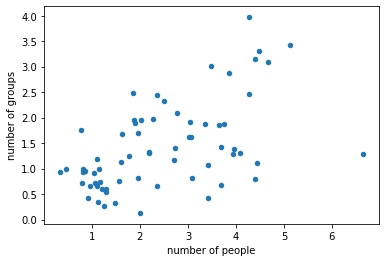

In [40]:
rel_books_df.plot.scatter(x="number of people",y="number of groups")

In [41]:
structural_features

['number of entities referred',
 'number of different entities referred',
 'number of people',
 'number of different number of people',
 'number of groups',
 'number of different number of groups',
 'number of places',
 'number of different number of places',
 'number of times',
 'number of different number of times',
 'number of works',
 'number of different number of works',
 'number of 1st level quotations',
 'number of 2nd level quotations',
 'number of 3rd level quotations',
 'number of 4th level quotations',
 'number of 5th level quotations',
 'number of 6th level quotations',
 'number of 7th level quotations',
 'number of quotations',
 'number of entities communicating',
 'number of different entities communicating',
 'number of entities receiving communication',
 'number of different entities receiving communication',
 'number of oral quotations',
 'number of dream quotations',
 'number of praying quotations',
 'number of oath quotations',
 'number of written quotations',
 'num

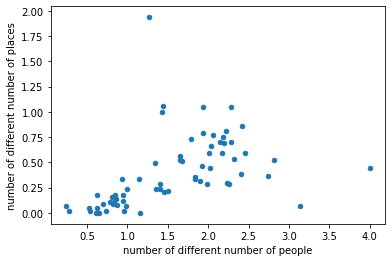

In [42]:
rel_books_df.plot.scatter(x="number of different number of people",y="number of different number of places")

In [44]:
import seaborn as sb

In [45]:
rel_books_df.loc["MAT"][structural_features].sort_values(ascending=False)

number of entities referred                             4.240896
number of different entities referred                   3.295051
number of groups                                        1.958917
number of people                                        1.874883
number of different number of groups                    1.543417
number of different number of people                    1.401494
number of entities receiving communication              1.118581
number of different entities receiving communication    1.090570
number of entities communicating                        0.935574
number of quotations                                    0.925303
number of different entities communicating              0.909430
number of oral quotations                               0.809524
number of 1st level quotations                          0.782446
number of places                                        0.342670
number of different number of places                    0.288515
number of 2nd level quota

In [46]:
2+2

4

In [47]:
df.loc[df["bible_identifier"] == "b.MAT.001.021"]

,bible_identifier,bible_book,bible_chapter,bible_book_chapter,genre,twitter_freq_sum_2014_2015,twitter_freq_2014,twitter_freq_2015,relations,monogamy,...,#org35,#org439,#pla65,#pla68,#per116,#per119,#pla67,#org52,#per129,#pla74
23165,b.MAT.001.021,MAT,001,MAT.001,gospel,17099,9944,7155,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


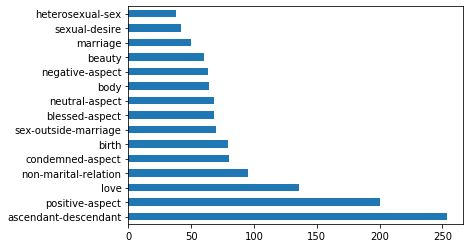

In [48]:
books_df[sexual_features].sum().sort_values(ascending=False)[0:15].plot.barh()

Text(0.5, 0, 'Frequency')

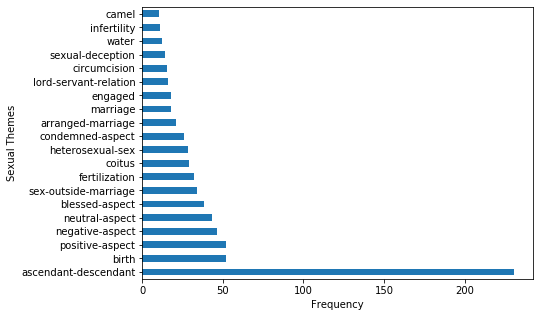

In [49]:
fig, axes = plt.subplots(nrows=1, ncols=1, figsize=(7,5))
books_df.loc["GEN"][sexual_features].sort_values(ascending=False)[0:20].plot.barh(ax = axes)
axes.set_ylabel("Sexual Themes")
axes.set_xlabel("Frequency")


In [50]:
books_df.loc["EXO"][sexual_features].sum().sum()

0.0

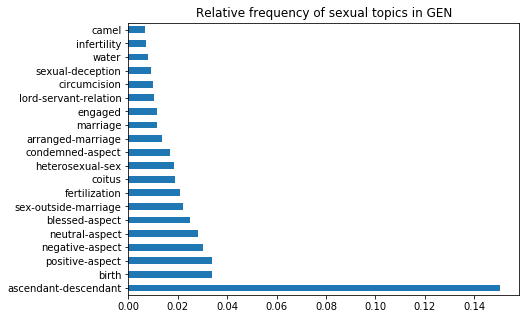

In [51]:
fig, axes = plt.subplots(nrows=1, ncols=1, figsize=(7,5))
rel_books_df.loc["GEN"][sexual_features].sort_values(ascending=False)[0:20].plot.barh(ax=axes)    
axes.set_title("Relative frequency of sexual topics in GEN")
fig.savefig("./../../../visualizations/features/bar_sexual_topics_GEN.png")

fig.show()


GEN
RUT
SON
MAT
JOH
1CO
REV


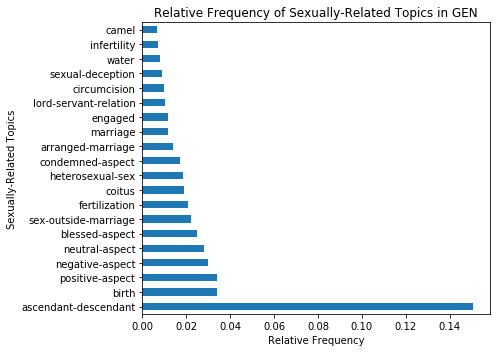

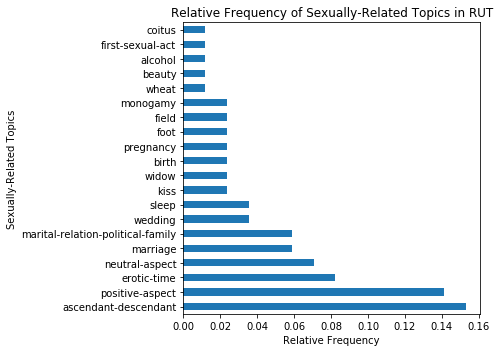

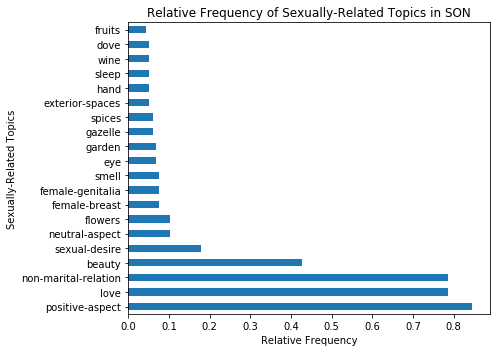

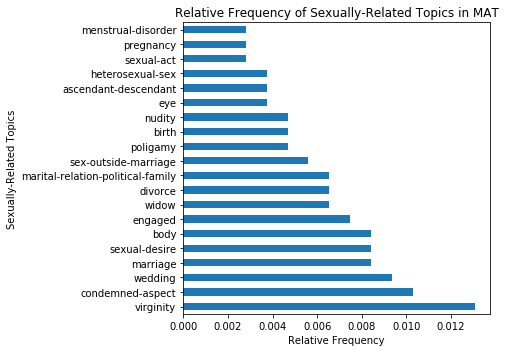

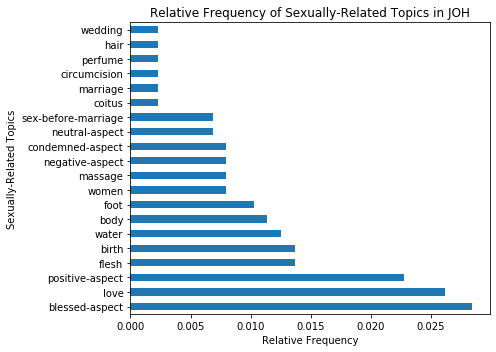

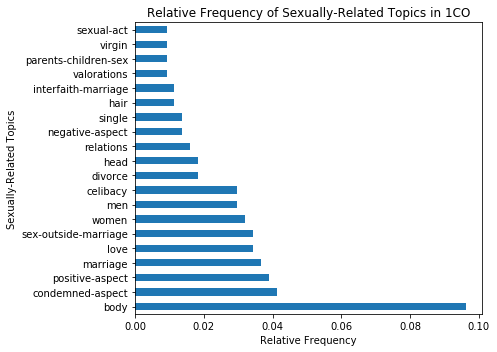

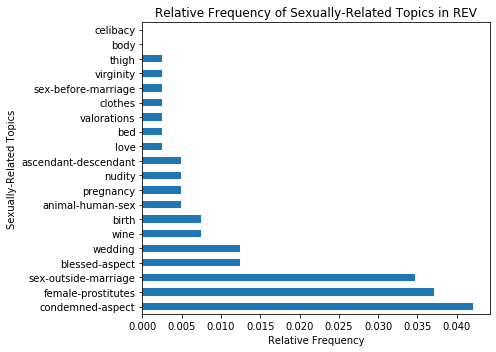

In [50]:
for book in books_df.index.tolist():

    if books_df.loc[book][sexual_features].sum().sum() > 0:
        print(book)

        fig, axes = plt.subplots(nrows=1, ncols=1, figsize=(7,5))
        rel_books_df.loc[book][sexual_features].sort_values(ascending=False)[0:20].plot.barh(ax=axes)    
        axes.set_title("Relative Frequency of Sexually-Related Topics in " + book)
        axes.set_ylabel("Sexually-Related Topics")
        axes.set_xlabel("Relative Frequency")

        plt.tight_layout()
        fig.savefig("./../../../visualizations/features/bar_sexual_topics_rel_" + book + ".png")
        fig.show()

GEN
RUT
SON
MAT
JOH
1CO
REV


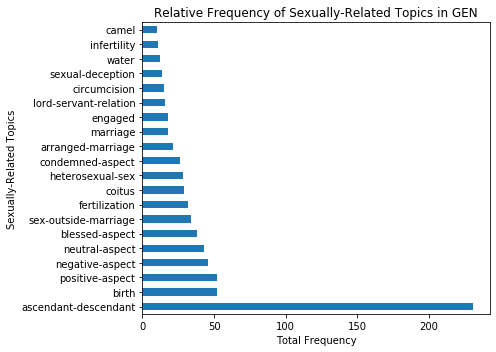

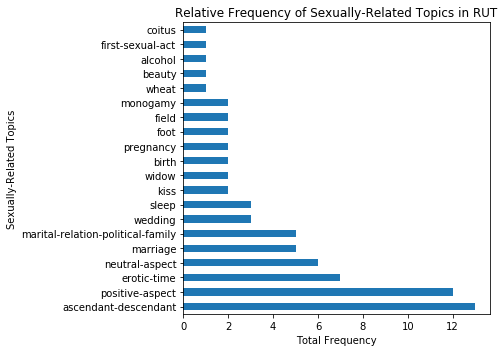

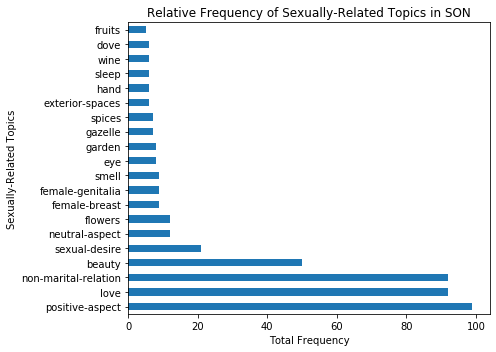

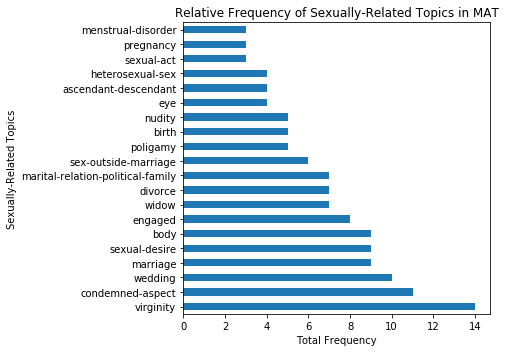

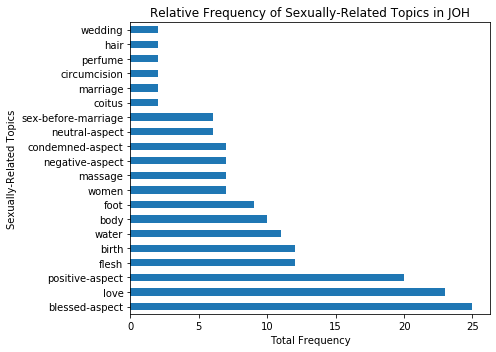

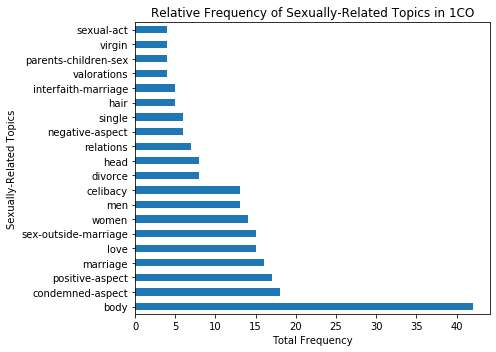

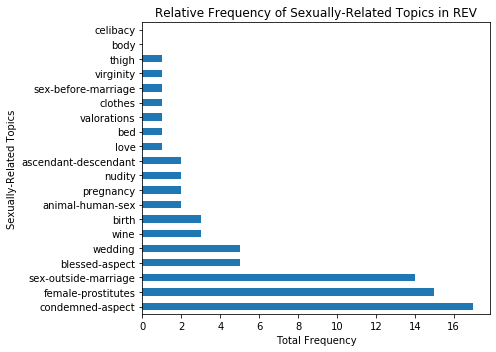

In [51]:
for book in books_df.index.tolist():

    if books_df.loc[book][sexual_features].sum().sum() > 0:
        print(book)

        fig, axes = plt.subplots(nrows=1, ncols=1, figsize=(7,5))
        books_df.loc[book][sexual_features].sort_values(ascending=False)[0:20].plot.barh(ax=axes)    
        axes.set_title("Relative Frequency of Sexually-Related Topics in " + book)
        axes.set_ylabel("Sexually-Related Topics")
        axes.set_xlabel("Total Frequency")
        plt.tight_layout()
        fig.savefig("./../../../visualizations/features/bar_sexual_topics_" + book + ".png")
        fig.show()

In [53]:
rel_books_df.loc["MAT"][entities_features].sort_values(ascending=False)[0:20].index.tolist()

['#per1',
 '#org0',
 '#org3',
 '#per14',
 '#org2',
 '#org18',
 '#per21',
 '#org5',
 '#org12',
 '#org19',
 '#org15',
 '#org25',
 '#pla19',
 '#pla18',
 '#per18',
 '#per50',
 '#org6',
 '#org4',
 '#org8',
 '#per23']

In [54]:
entities_df

,order,id,NormalizedName-sp,aclaration,variants,comments,book,cert,wikidata id,cert_wikidata,...,PHM,HEB,JAM,1PE,2PE,1JO,2JO,3JO,JUD,REV
id,,,,,,,,,,,,,,,,,,,,,
#per0,2.0,#per0,persona no definida,NaN,NaN,NaN,NT,NaN,NaN,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
#per1,3.0,#per1,Jesús,NaN,NaN,NaN,NT,NaN,Q302,NaN,...,13.0,75.0,5.0,34.0,24.0,48.0,7.0,0.0,8.0,102.0
#per2,4.0,#per2,Abraham,NaN,Abram,NaN,AT,NaN,Q9181,NaN,...,0.0,13.0,4.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0
#per3,5.0,#per3,Isaac,NaN,NaN,NaN,AT,NaN,Q671872,NaN,...,0.0,7.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
#per4,6.0,#per4,Jacob,NaN,Israel,NaN,AT,NaN,Q289957,NaN,...,0.0,5.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
#wor17,3985.0,#wor17,libro de Isaías,NaN,NaN,NaN,NaN,NaN,0,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
#wor18,3986.0,#wor18,libros de Lamentos,NaN,NaN,NaN,NaN,NaN,0,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
#ani0,3987.0,#ani0,animales,NaN,NaN,NaN,NaN,NaN,0,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [55]:
#entities_df.values.max()

In [56]:
[entity for entity in rel_books_df.loc["GEN"][entities_features].sort_values(ascending=False)[0:100].index.tolist() if ("org" in               entity or "per" in entity ) and "per0" not in entity ]

['#per4',
 '#per14',
 '#per104',
 '#per2',
 '#org88',
 '#per3',
 '#per131',
 '#per132',
 '#per133',
 '#per134',
 '#per136',
 '#org83',
 '#per5',
 '#per16',
 '#org0',
 '#org4',
 '#per135',
 '#per47',
 '#per137',
 '#per128',
 '#per138',
 '#per158',
 '#per145',
 '#per144',
 '#per109',
 '#per159',
 '#per140',
 '#per162',
 '#per143',
 '#org78',
 '#per241',
 '#org65',
 '#per139',
 '#per161',
 '#per142',
 '#per150',
 '#per195',
 '#per6',
 '#org63',
 '#per124',
 '#per189',
 '#per72',
 '#per157',
 '#per152',
 '#per267',
 '#per173',
 '#org80',
 '#per125',
 '#per149',
 '#org94',
 '#org84',
 '#per156',
 '#per43',
 '#org53',
 '#per196',
 '#per172',
 '#org150',
 '#org18',
 '#per181',
 '#per141',
 '#per180',
 '#per126',
 '#per245',
 '#per227',
 '#org86',
 '#per178',
 '#per146',
 '#org79',
 '#per395',
 '#per186',
 '#per20',
 '#per197',
 '#per127',
 '#per148',
 '#per177',
 '#per171',
 '#org85',
 '#per153',
 '#per460',
 '#per160',
 '#per121',
 '#per205',
 '#per169']

In [ ]:
df.loc

In [54]:
def make_heatmap_sexual_entities(rel_books_df, df, entities_df, books = rel_books_df.index.tolist(),
extra_entity = [], nr_entities = 15, nr_topics = 15, figsize = (8,8), replace_with_language = "sp", replace_ids_with_names = True):

    for book in books:

        if rel_books_df.loc[book][sexual_features].sum().sum() > 0:
            print(book)
            most_frequent_sexual_topics = rel_books_df.loc[book][sexual_features].sort_values(ascending=False)[0:nr_topics].index.tolist()
            most_frequent_entities = [entity for entity in rel_books_df.loc[book][entities_features].sort_values(ascending=False)[0:nr_entities].index.tolist() if ("org" in               entity or "per" in entity ) and "per0" not in entity ]
            most_frequent_entities += extra_entity


            coappereance_df = pd.DataFrame(index = most_frequent_sexual_topics, columns = most_frequent_entities)
            for theme in most_frequent_sexual_topics:
                for entity in most_frequent_entities:
                    try:
                        coappereance_df.loc[theme, entity] = (len(df.loc[(df["bible_book"] == book) & (df[theme] > 0) & (df[entity] > 0) ].fillna(0)) / len(df.loc[(df["bible_book"] == book) & (df[entity] > 0) ].fillna(0)) )
                    except:
                        coappereance_df.loc[theme, entity] = 0
            
            #coappereance_df = coappereance_df[coappereance_df.sum().sort_values(ascending=False).index.tolist()]
            coappereance_df = coappereance_df.loc[coappereance_df.sum(axis="columns").sort_values(ascending=False).index.tolist()]
            #coappereance_df.sum().sort_values(ascending=False)



            if replace_ids_with_names == True:

                coappereance_df = coappereance_df.rename(entities_df["NormalizedName-" + replace_with_language].to_dict(), axis="columns")


            coappereance_df["sum"] = coappereance_df.sum(axis="columns")
            coappereance_df = coappereance_df.T
            coappereance_df["sum"] = coappereance_df.sum(axis="columns")
            coappereance_df = coappereance_df.T


            print(coappereance_df)


            
            fig, axes = plt.subplots(nrows=1, ncols=1, figsize = figsize)

            sns.heatmap(coappereance_df.fillna(0).round(2) * 100, vmin=0, vmax = coappereance_df.iloc[:-1,:-1].values.max() *100, cmap="Reds", ax=axes, robust=True, annot=True, linewidths=.5, fmt='g')
            axes.title.set_text("Heatmap of Coappearence between \nSexual Themes and Entities in " + book + " (in Percentage)")

            for tick in axes.get_xticklabels(): tick.set_rotation(70)
            plt.tight_layout()
            fig.savefig("./../../../visualizations/features/" + book +"_coappearence_sexual_themes_entities_" + replace_with_language + ".png")


GEN
                            Jacob        Dios        José     Abraham  \
ascendant-descendant    0.0863309    0.138686   0.0422535    0.179104   
positive-aspect         0.0503597    0.026764   0.0211268   0.0335821   
engaged                 0.0191847  0.00729927  0.00352113   0.0223881   
blessed-aspect          0.0143885   0.0754258           0   0.0858209   
negative-aspect         0.0239808   0.0145985   0.0246479   0.0186567   
neutral-aspect          0.0143885   0.0145985  0.00704225   0.0373134   
birth                   0.0383693   0.0291971  0.00704225   0.0223881   
condemned-aspect       0.00239808   0.0218978           0   0.0485075   
marriage               0.00479616  0.00729927           0   0.0149254   
fertilization           0.0167866   0.0389294  0.00704225    0.011194   
coitus                  0.0191847  0.00973236   0.0176056  0.00746269   
sex-outside-marriage   0.00719424  0.00973236   0.0211268   0.0186567   
heterosexual-sex        0.0119904  0.00729927  

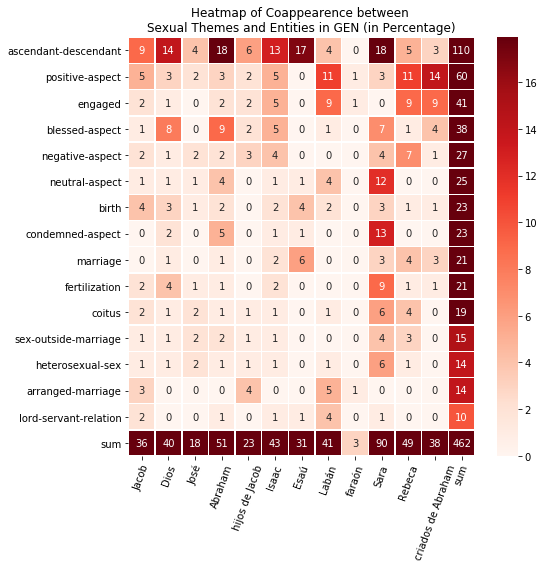

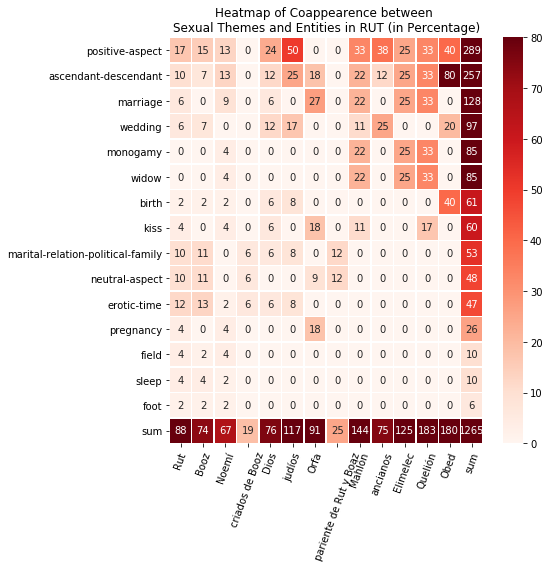

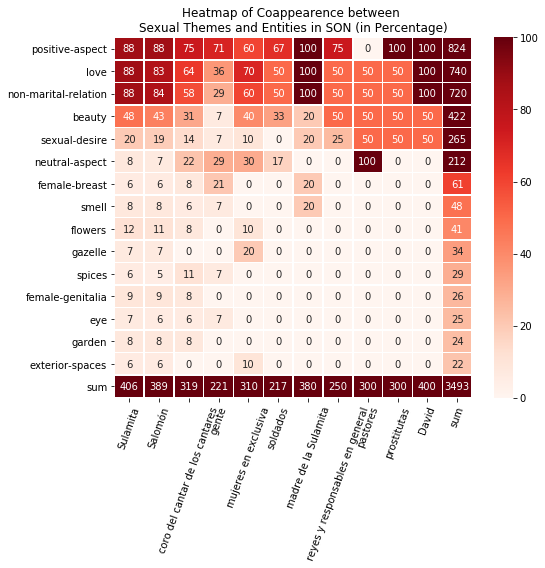

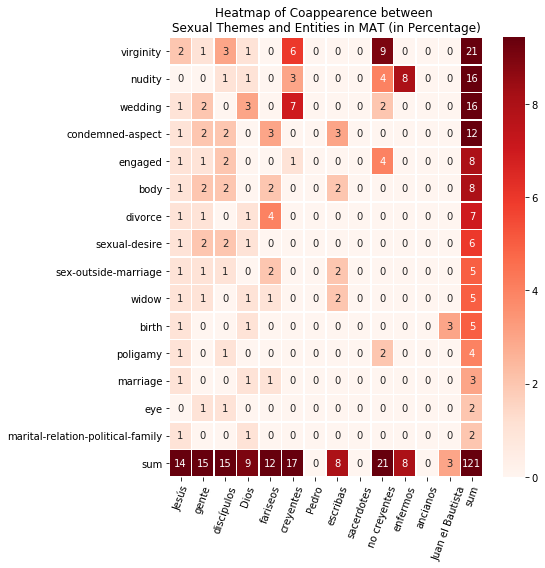

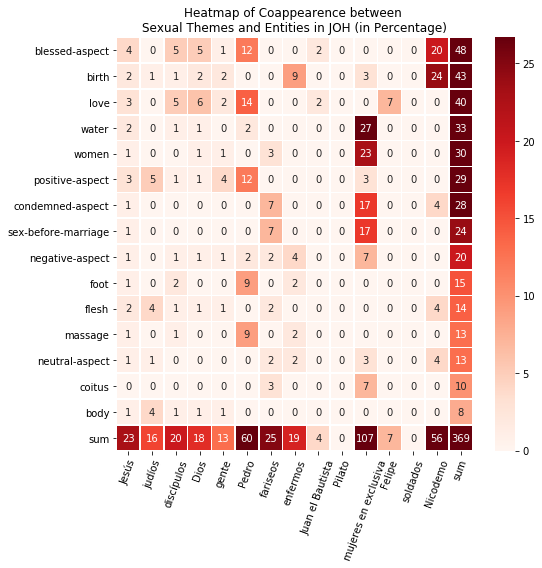

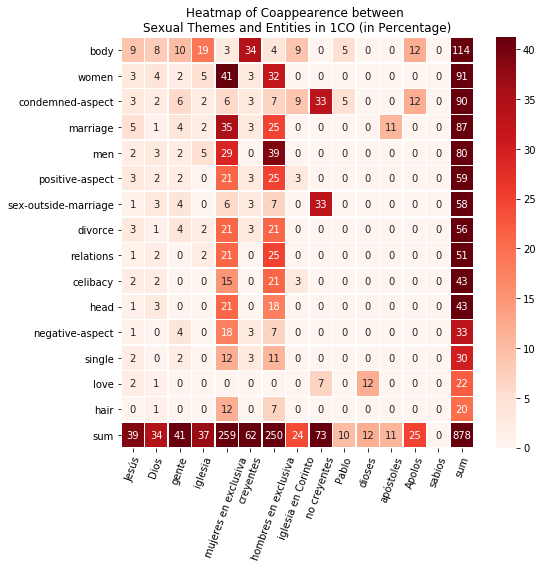

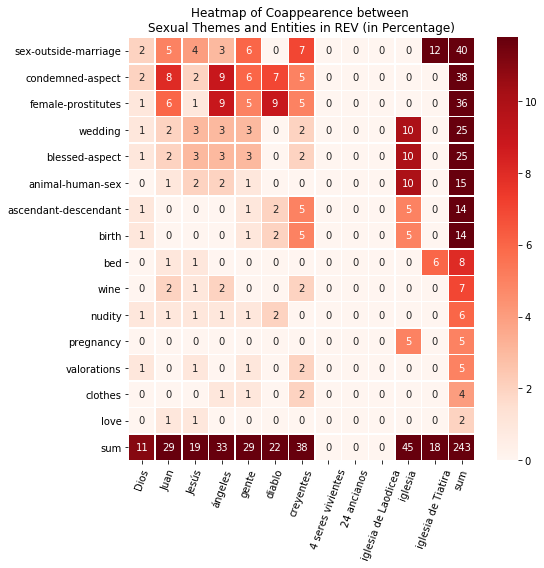

In [58]:
make_heatmap_sexual_entities(rel_books_df, df, entities_df)

MAT
                                        Jesus      people disciples  \
virginity                           0.0166074   0.0124378     0.026   
birth                               0.0059312  0.00497512     0.002   
nudity                             0.00474496           0     0.008   
wedding                             0.0118624   0.0199005     0.002   
condemned-aspect                    0.0130486   0.0248756     0.022   
widow                              0.00830368  0.00746269     0.002   
engaged                            0.00948992  0.00746269     0.016   
body                                0.0106762   0.0199005     0.018   
marriage                            0.0106762  0.00497512     0.004   
divorce                            0.00830368  0.00746269     0.004   
marital-relation-political-family  0.00711744  0.00497512         0   
sexual-desire                       0.0106762   0.0174129     0.018   
sex-outside-marriage               0.00711744  0.00746269     0.006   
po

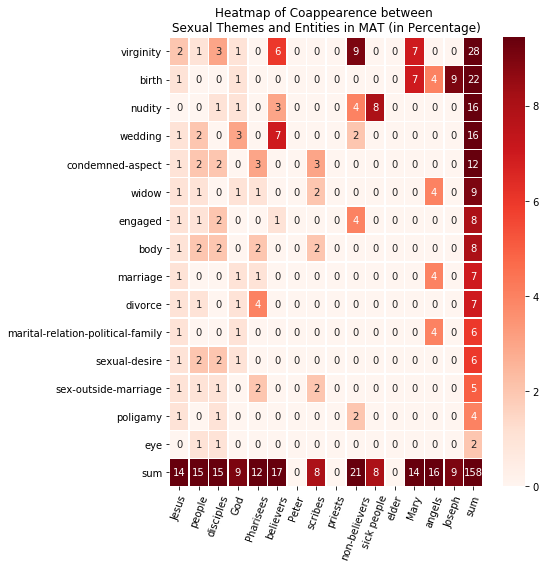

In [61]:
make_heatmap_sexual_entities(rel_books_df, df, entities_df, books = ["MAT"], extra_entity=["#per11", "#org4", "#per12"], replace_with_language= "en", nr_entities = 12)

MAT
                                        #per1       #org0  #org3      #per14  \
virginity                           0.0166074   0.0124378  0.026  0.00578035   
nudity                             0.00474496           0  0.008  0.00578035   
wedding                             0.0118624   0.0199005  0.002   0.0346821   
condemned-aspect                    0.0130486   0.0248756  0.022           0   
birth                               0.0059312  0.00497512  0.002  0.00578035   
engaged                            0.00948992  0.00746269  0.016           0   
body                                0.0106762   0.0199005  0.018           0   
divorce                            0.00830368  0.00746269  0.004  0.00578035   
sexual-desire                       0.0106762   0.0174129  0.018   0.0115607   
sex-outside-marriage               0.00711744  0.00746269  0.006           0   
widow                              0.00830368  0.00746269  0.002  0.00578035   
poligamy                            

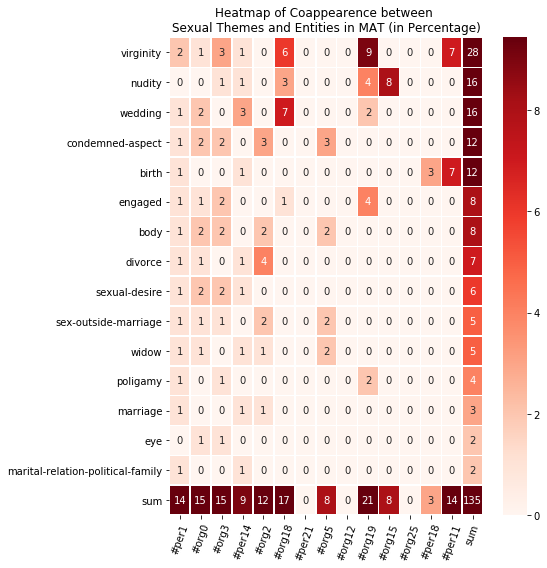

In [62]:
make_heatmap_sexual_entities(rel_books_df, df, entities_df, books = ["MAT"], extra_entity=["#per11"], replace_with_language= "ids", replace_ids_with_names = False)